<a href="https://colab.research.google.com/github/DeepCodeSec/ml1000-p2/blob/wine-quality-white/notebooks/project2_wine_clustering.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Project 2 - Cluster wines based on their chemical constituents

**Objective** The objective of this study is to use clustering analysis to try and find associations within physicochemical properties in white wines. We will try to find interesting things that our client LCBO can use to increase sales by using the white wine quality dataset retrieved from the UCI Machine learning repository: https://archive.ics.uci.edu/ml/datasets/Wine+Quality.

#Install Packages and Load in Dataset


In [ ]:
!pip install pycaret
!pip install pandas_profiling 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 320.2/320.2 KB 5.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.6/56.6 KB 3.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 13.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 25.8/25.8 MB 10.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.0/5.0 MB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 21.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 22.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 167.1/167.1 KB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 324.4/324.4 KB 22.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.7/147.7 KB 5.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 25.

#Importing the Dataset

In [ ]:
# Link or path to the dataset to use
df_path = "https://github.com/DeepCodeSec/ml1000-p1/blob/main/data/winequality-white.csv?raw=true"

In [ ]:
#load csv into dataframe
import pandas as pd

dataset = pd.read_csv(df_path, 
                      sep=';') #the separater in the raw data is ;. need to indicate so columns are found
dataset.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.0,0.27,0.36,20.7,0.045,45.0,170.0,1.0010,3.00,0.45,8.8,6
1,6.3,0.30,0.34,1.6,0.049,14.0,132.0,0.9940,3.30,0.49,9.5,6
2,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
3,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6
4,7.2,0.23,0.32,8.5,0.058,47.0,186.0,0.9956,3.19,0.40,9.9,6


The code below automatically creates an exploratory data analysis report which is output as an html file in the local files. What follows are the highlights of this Exploratory Data Analysis (EDA) report: 

#Exploratory Data Analysis

In [ ]:
#Load libraries for exploratory analysis
import numpy as np
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt

pr = ProfileReport(dataset)
pr.to_file(output_file="EDA.html")

<ipython-input-4-f2a825195cc6>:3: DeprecationWarning: `import pandas_profiling` is going to be deprecated by April 1st. Please use `import ydata_profiling` instead.
  from pandas_profiling import ProfileReport


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#check the shape of data
dataset.shape

(4898, 12)

In [ ]:
#see a details about the data
dataset.describe().T

,count,mean,std,min,25%,50%,75%,max
fixed acidity,4898.0,6.854788,0.843868,3.80000,6.300000,6.80000,7.3000,14.20000
volatile acidity,4898.0,0.278241,0.100795,0.08000,0.210000,0.26000,0.3200,1.10000
citric acid,4898.0,0.334192,0.121020,0.00000,0.270000,0.32000,0.3900,1.66000
residual sugar,4898.0,6.391415,5.072058,0.60000,1.700000,5.20000,9.9000,65.80000
chlorides,4898.0,0.045772,0.021848,0.00900,0.036000,0.04300,0.0500,0.34600
free sulfur dioxide,4898.0,35.308085,17.007137,2.00000,23.000000,34.00000,46.0000,289.00000
total sulfur dioxide,4898.0,138.360657,42.498065,9.00000,108.000000,134.00000,167.0000,440.00000
density,4898.0,0.994027,0.002991,0.98711,0.991723,0.99374,0.9961,1.03898
pH,4898.0,3.188267,0.151001,2.72000,3.090000,3.18000,3.2800,3.82000
sulphates,4898.0,0.489847,0.114126,0.22000,0.410000,0.47000,0.5500,1.08000


In [ ]:
#basic structure of dataframe
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4898 entries, 0 to 4897
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         4898 non-null   float64
 1   volatile acidity      4898 non-null   float64
 2   citric acid           4898 non-null   float64
 3   residual sugar        4898 non-null   float64
 4   chlorides             4898 non-null   float64
 5   free sulfur dioxide   4898 non-null   float64
 6   total sulfur dioxide  4898 non-null   float64
 7   density               4898 non-null   float64
 8   pH                    4898 non-null   float64
 9   sulphates             4898 non-null   float64
 10  alcohol               4898 non-null   float64
 11  quality               4898 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 459.3 KB


In [ ]:
#see number of missing values for each column
dataset.isnull().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

In [ ]:
dataset.skew()

fixed acidity           0.647751
volatile acidity        1.576980
citric acid             1.281920
residual sugar          1.077094
chlorides               5.023331
free sulfur dioxide     1.406745
total sulfur dioxide    0.390710
density                 0.977773
pH                      0.457783
sulphates               0.977194
alcohol                 0.487342
quality                 0.155796
dtype: float64

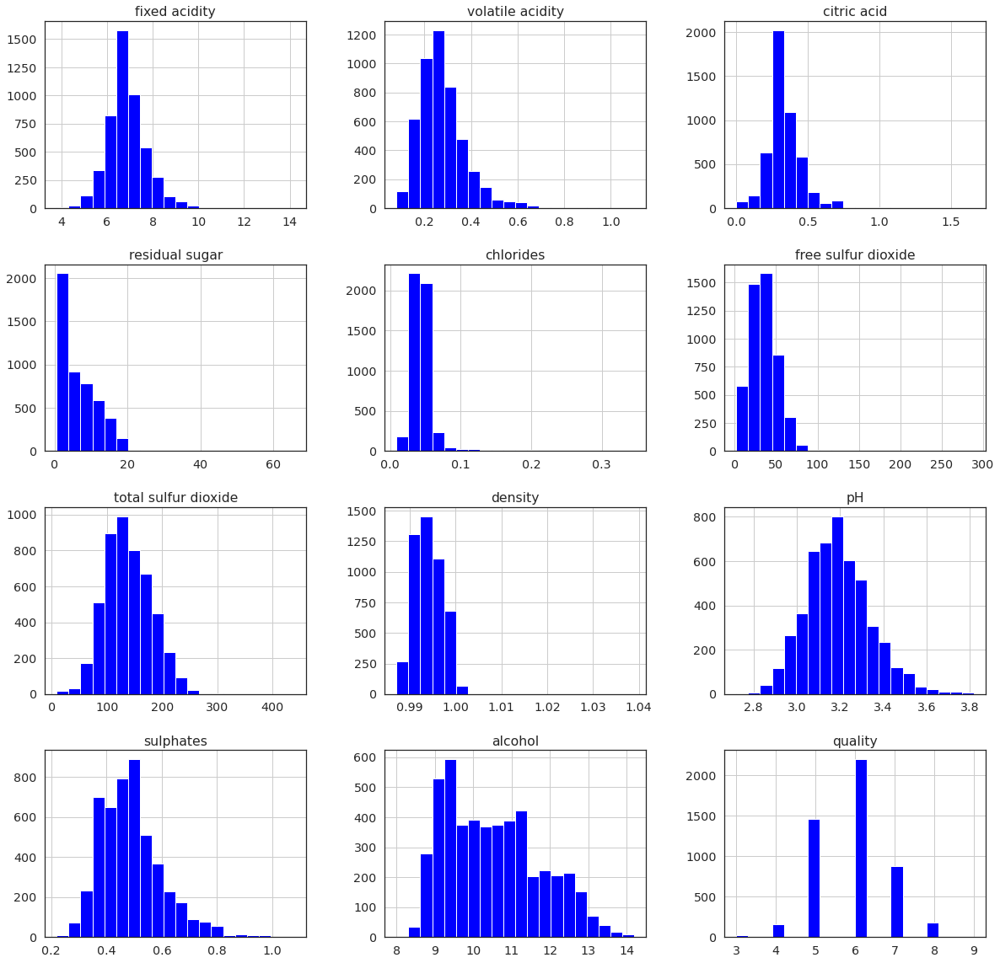

In [ ]:
#ploting histograms to better visualize the distributions of every feature for better insights
import seaborn as sns

sns.set(style='white',font_scale=1.3, rc={'figure.figsize':(20,20)})
ax=dataset.hist(bins=20,color='blue' )

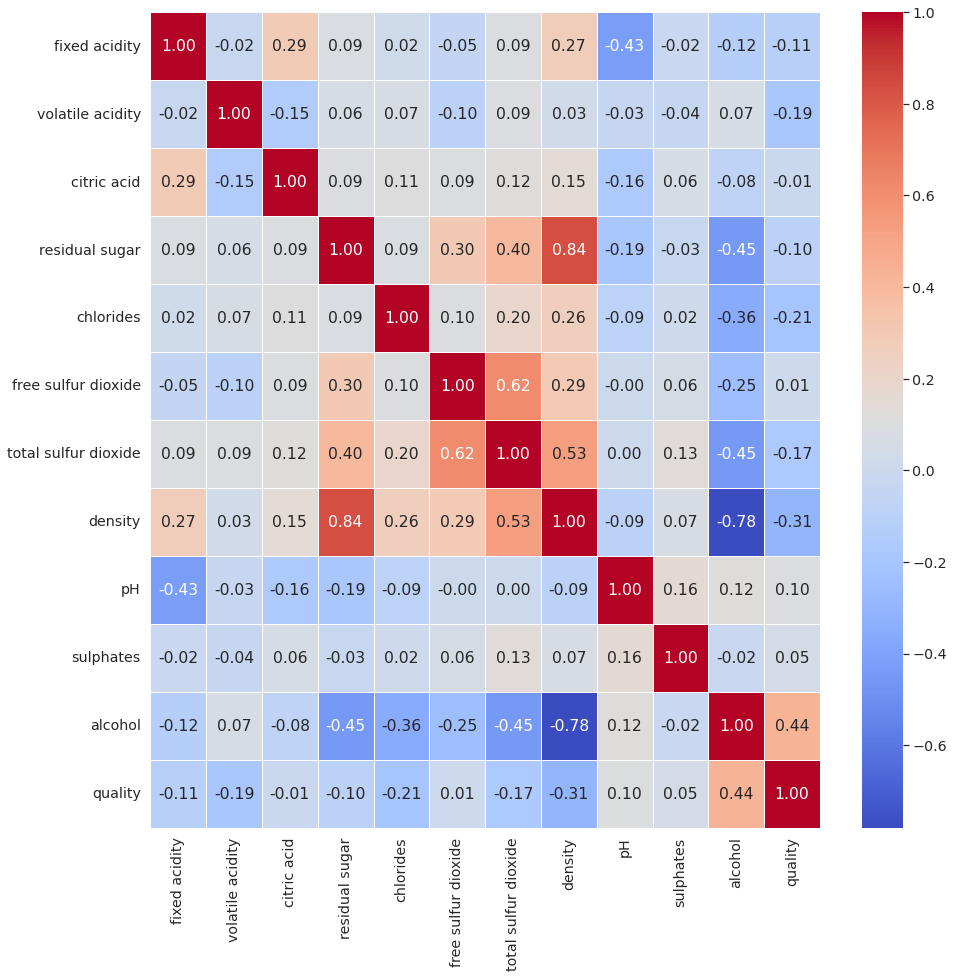

In [ ]:
plt.figure(figsize=(15,15))
sns.heatmap(dataset.corr(),annot=True,fmt=".2f",linewidths=0.7,cmap="coolwarm")
plt.show()

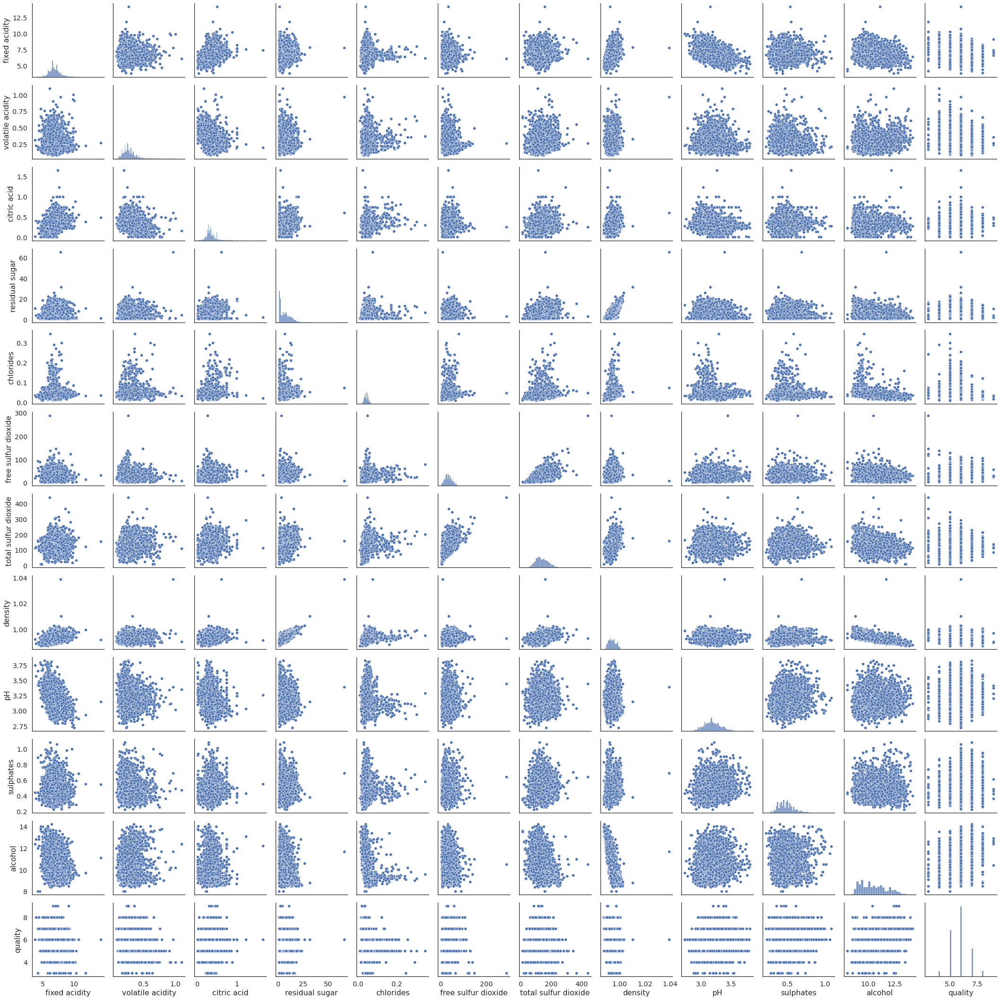

In [ ]:
#create the default pairplot
sns.pairplot(dataset)
plt.show()

**Summary of Data**

* 12 variables
* 4898 observations
* 772 duplicate rows
* No missing values
* High Correlations:
> * residual sugar is highly correlated with density
> * chlorides is highly correlated with density and alcohol
> * free sulfur dioxide is highly overall correlated with total sulfur dioxide
> * total sulfur dioxide is highly overall correlated with free sulfur dioxide and density
> * density is highly overall correlated with residual sugar, chlorides, total sulfur dioxide and alcohol.
> * alcohol is highly overall correlated with chorides and density
* There are widely different ranges. On one extreme, chlorides has a range of 0.009 - 0.346, while free sulfur dioxide has a range of 2 - 289.

A sample of 5% has been withheld from the original dataset to be used for predictions at the end of the experiment.

In [ ]:
# Split the data into 95% and 5%
data = dataset.sample(frac=0.95, random_state=786)
data_unseen = dataset.drop(data.index)
data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (4653, 12)
Unseen Data For Predictions: (245, 12)


In [ ]:
data.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.9,0.28,0.49,7.7,0.045,48.0,195.0,0.99540,3.04,0.55,11.0,6
1,5.0,0.24,0.19,5.0,0.043,17.0,101.0,0.99438,3.67,0.57,10.0,5
2,8.3,0.26,0.31,2.0,0.029,14.0,141.0,0.99077,2.95,0.77,12.2,6
3,7.7,0.25,0.30,7.8,0.038,67.0,196.0,0.99555,3.10,0.50,10.1,5
4,4.4,0.32,0.39,4.3,0.030,31.0,127.0,0.98904,3.46,0.36,12.8,8


In [ ]:
data_unseen.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
1,8.6,0.23,0.40,4.2,0.035,17.0,109.0,0.9947,3.14,0.53,9.7,5
2,6.6,0.16,0.40,1.5,0.044,48.0,143.0,0.9912,3.54,0.52,12.4,7
3,7.4,0.34,0.42,1.1,0.033,17.0,171.0,0.9917,3.12,0.53,11.3,6
4,6.0,0.19,0.26,12.4,0.048,50.0,147.0,0.9972,3.30,0.36,8.9,6


## Data Cleaning

Here we make our data cleaning decisions. We have decided to leave the duplicates in because they they are likely combinations of variable values and should get a higher weight because of it. The data does not contain any missing values, so no imputation or row removal was needed. Exploratory data analysis revealed the numeric features have varying scales and several are non-normally distributed. We will address both in the experiment setup section. Finally, we need to check the data for outliers.

### Outlier analysis

Two options: 
1.   When lots of observations in dataset and only a few rows with outlier values (for any column), just remove rows containing outliers. Alternatively, we leave the feww outliers as is because they may be potentially informative.

2.   When fewer observations and more rows containing outlier values, cap the values at the 5th and 95th percentiles.

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


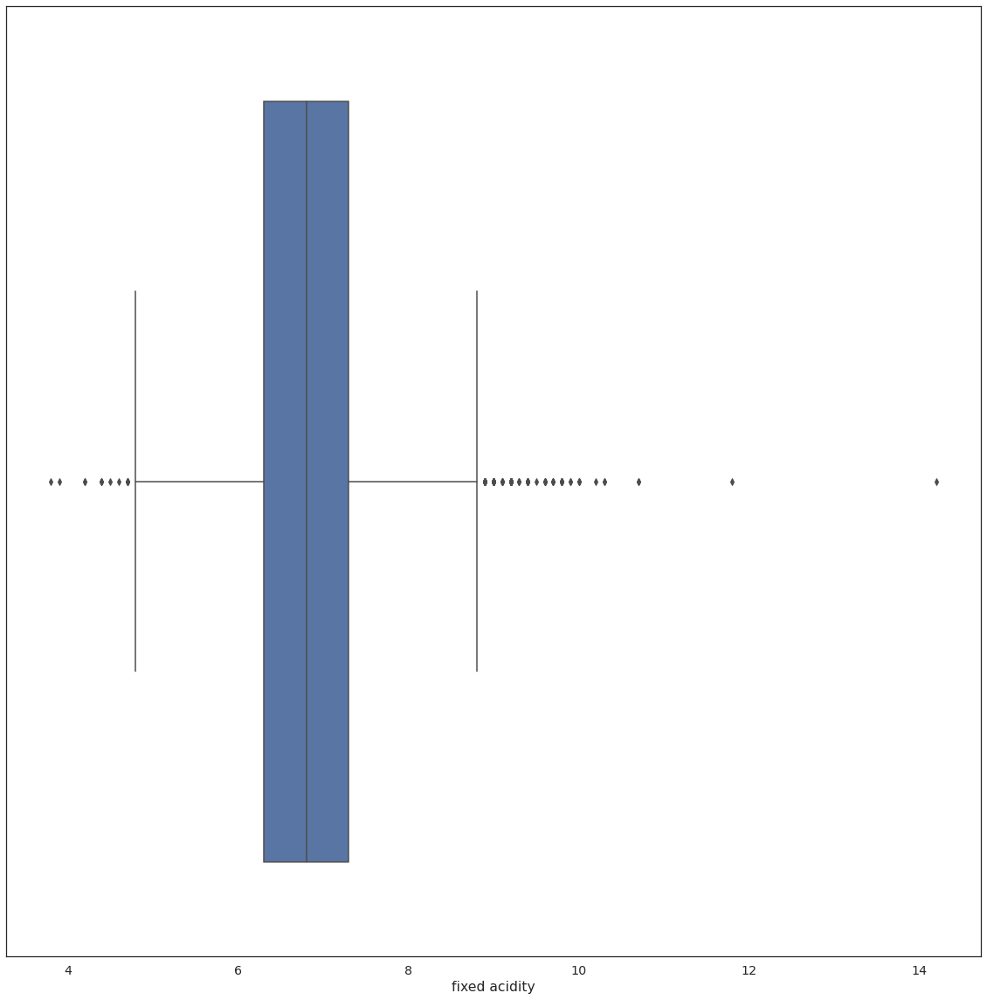

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


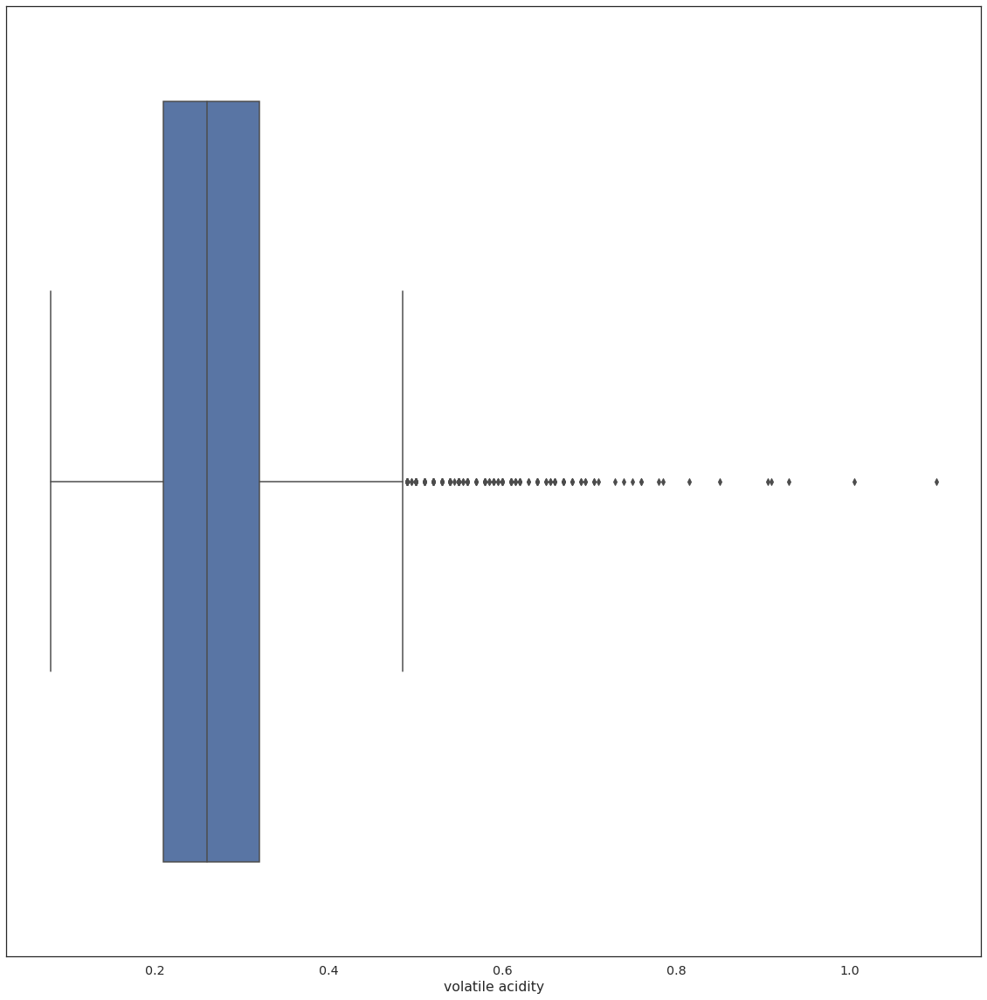

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


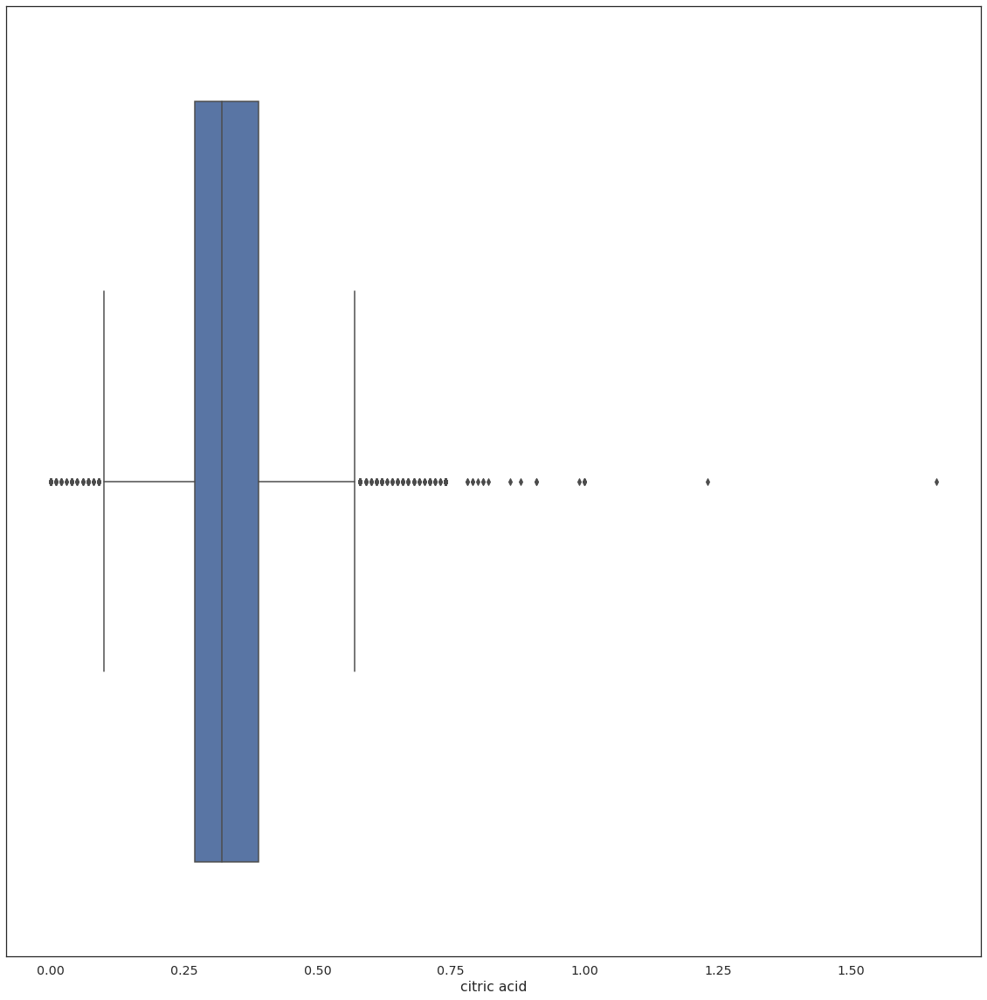

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


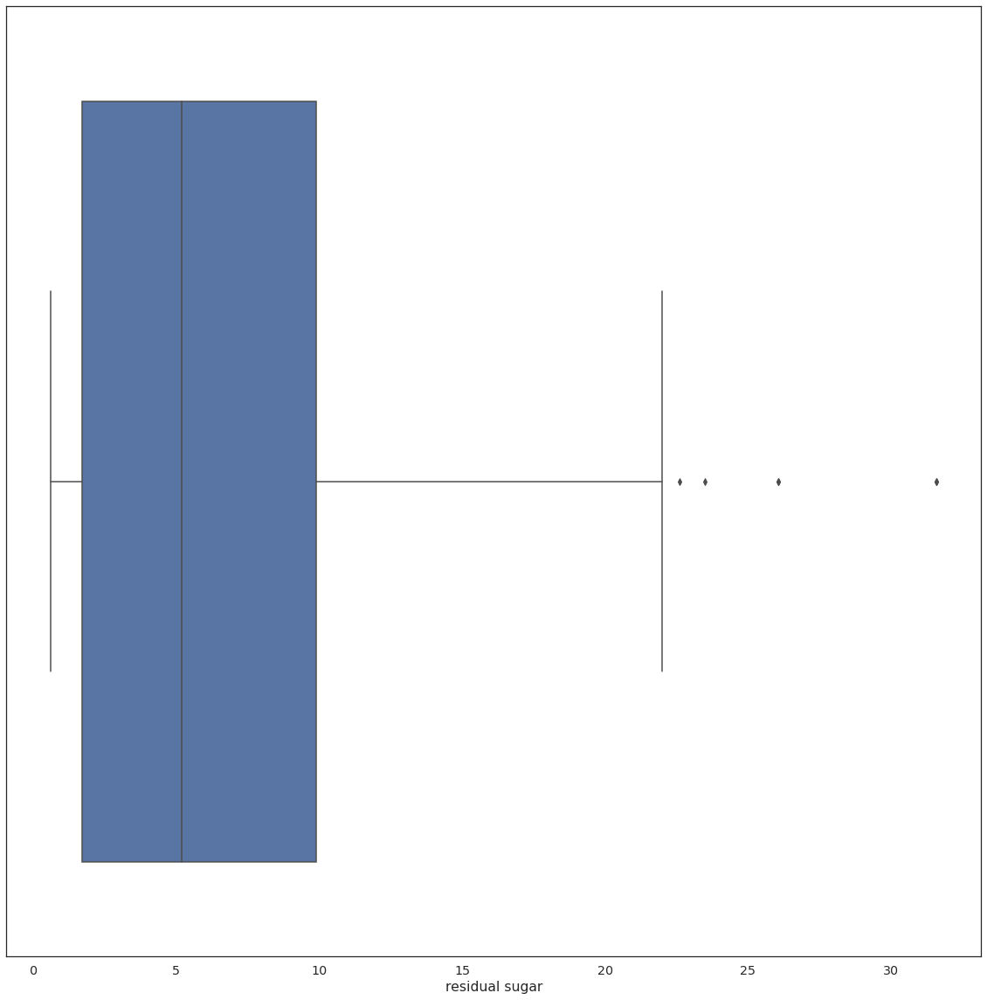

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


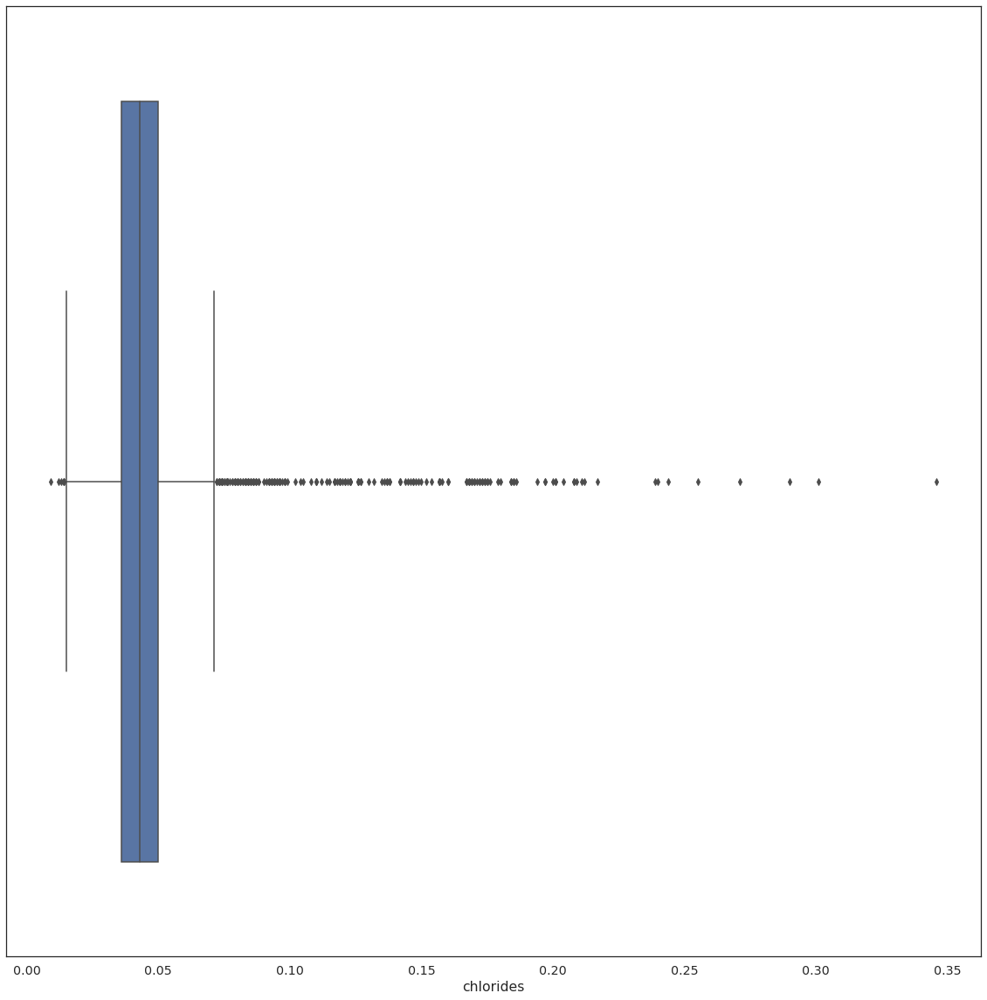

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


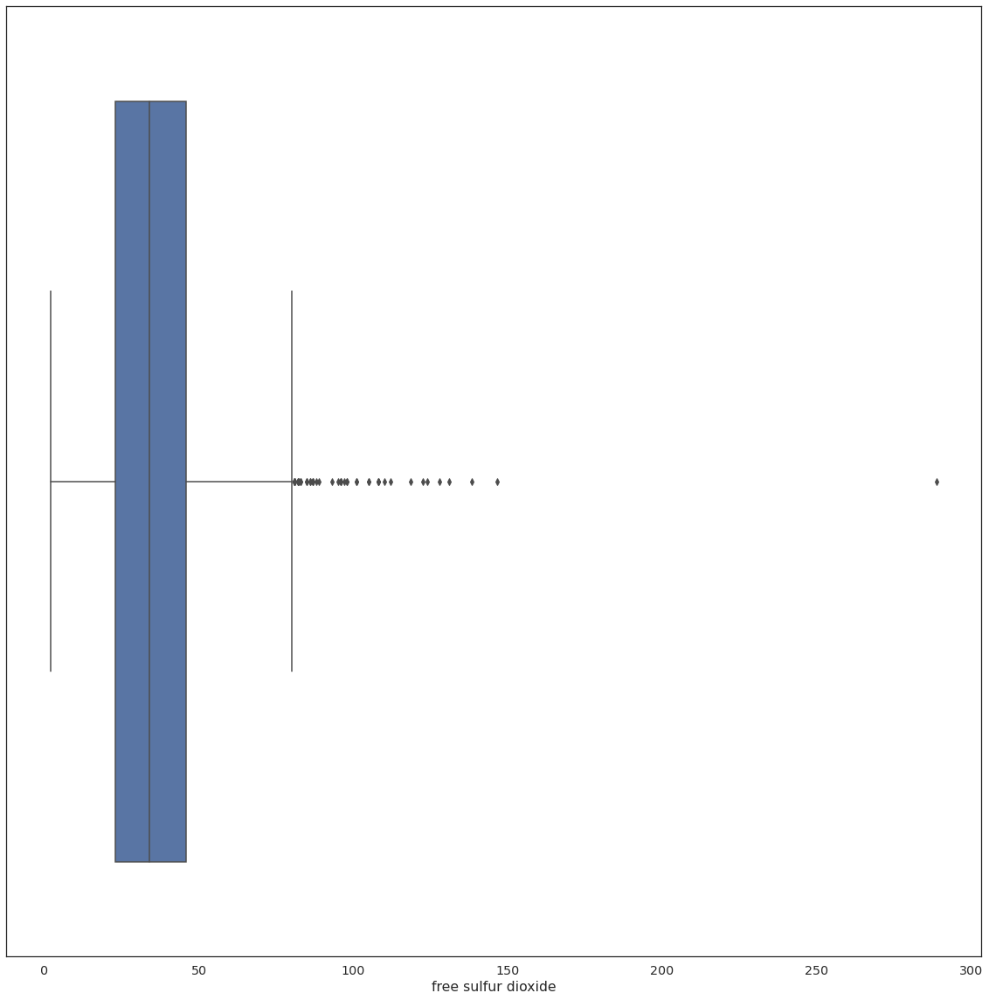

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


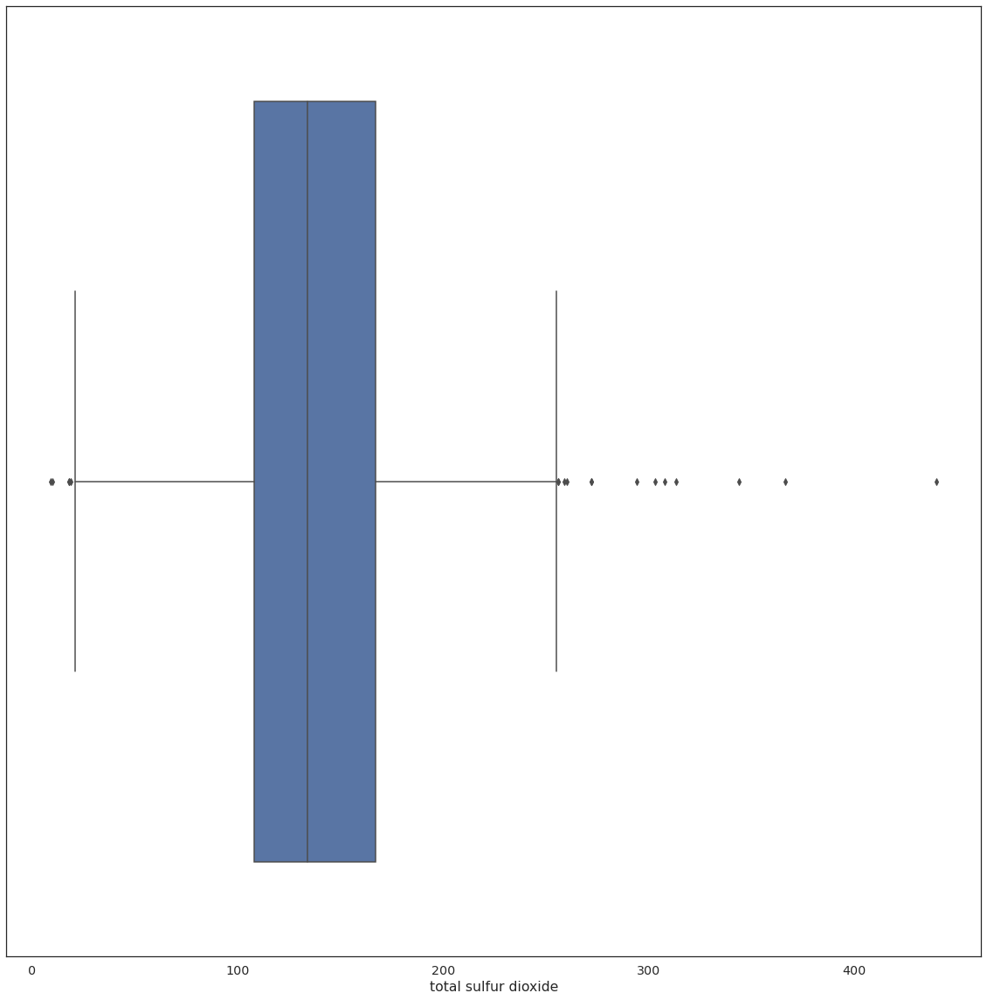

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


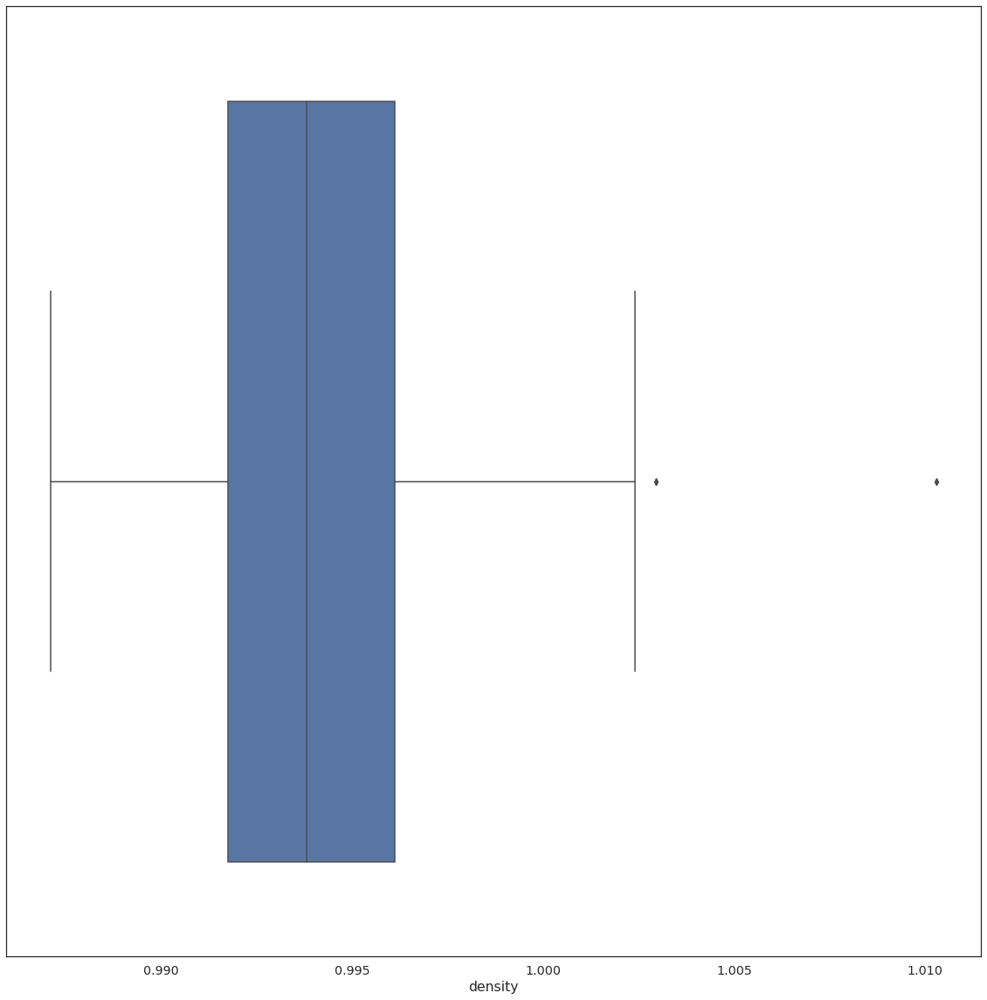

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


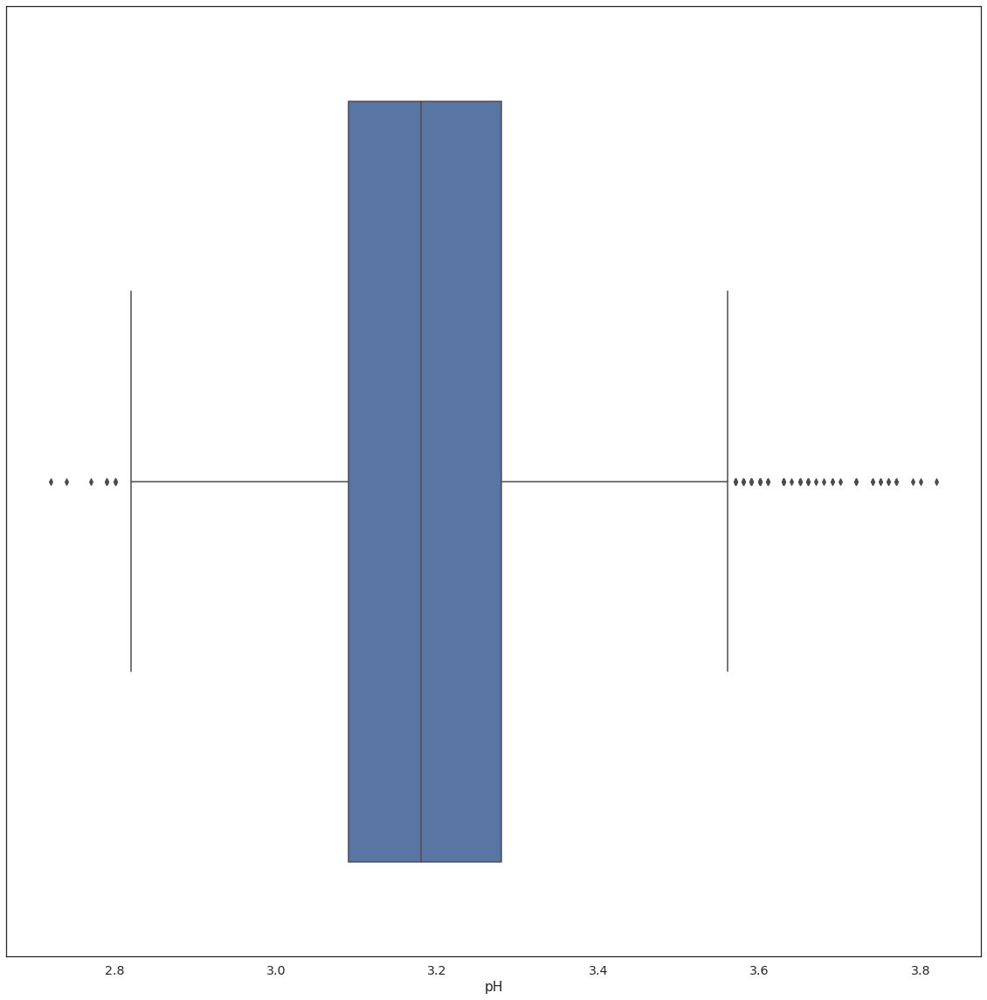

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


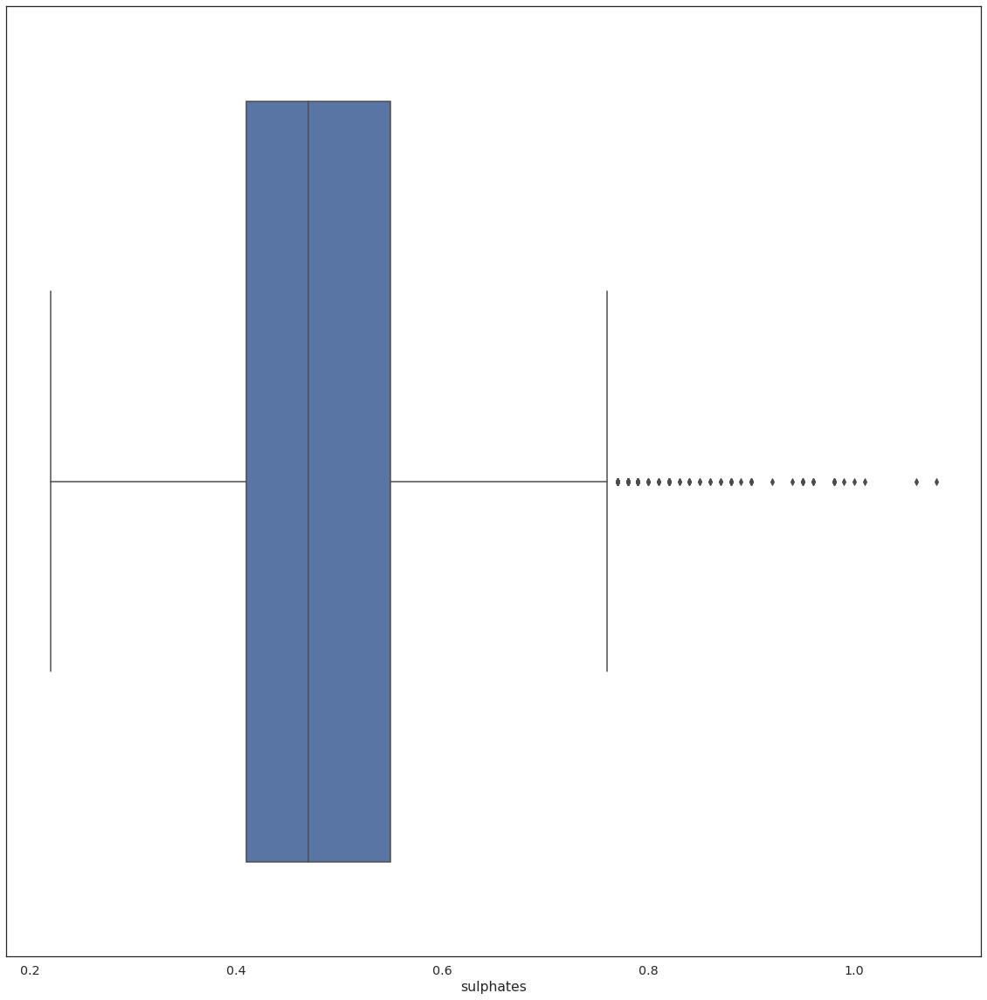

/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


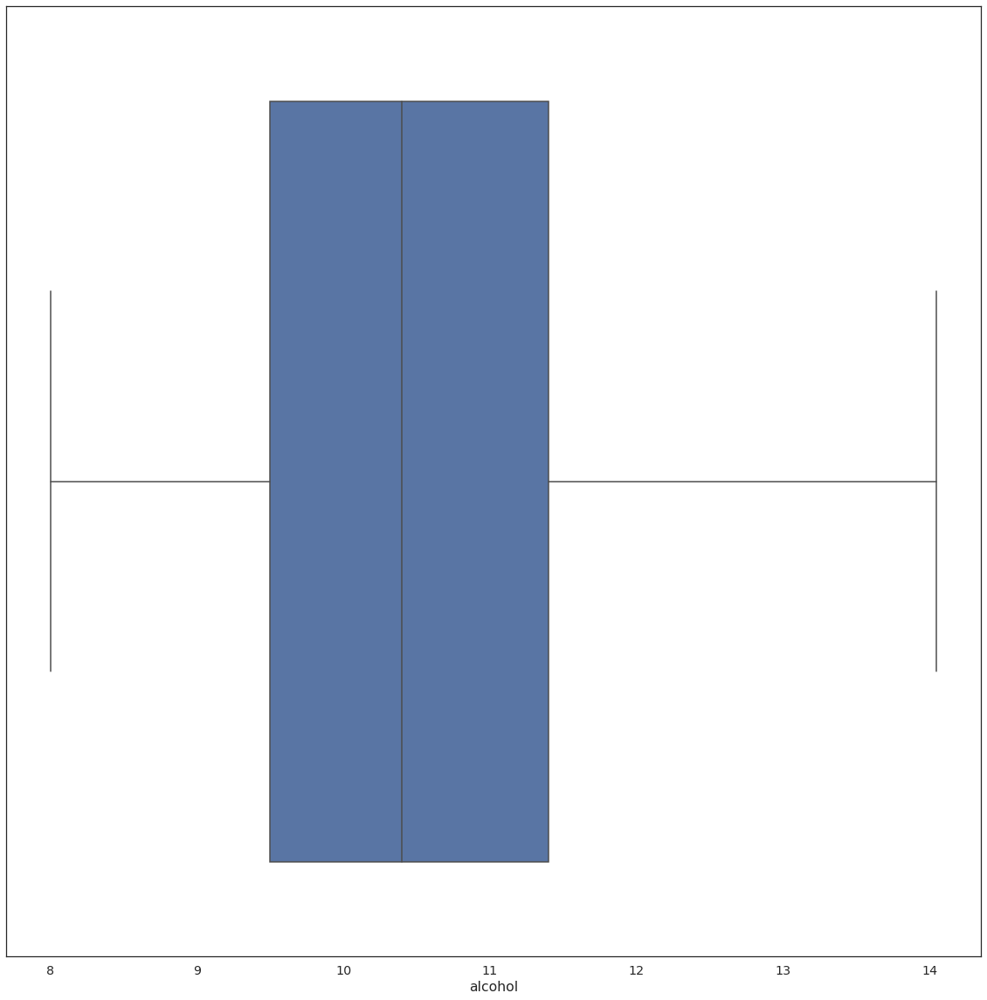

In [ ]:
# Outlier analysis
cols = list(data.columns)

#Create boxplot for every numeric feature (cols 0-11) to show outliers
for col in cols[0:-1]:
  plt.figure()
  sns.boxplot(data[col])
  plt.show()

The boxplots indicate that most of the predictors contain outlier values. Some of these predictors, like chlorides, contain a large number of outliers. Since there are so many outlier values, removing rows that contain outliers could leave us with a very small fraction of the original data. We opt to cap the values at the 5th and 95th percentiles to retain as much data as possible.

In [ ]:
tmp = data #creating a temporary to avoid accidentally overwriting the original (let's us compare and verify capping)
data_clean = data

In [ ]:
cols = list(data.columns)

#Create boxplot for every numeric feature (cols 0-13) to show outliers
for col in cols[0:-1]:
  upper_limit = tmp[col].mean() + 3*tmp[col].std() #~95th percentile
  lower_limit = tmp[col].mean() - 3*tmp[col].std() #~5th percentile
  
  data_clean[col] = np.where(tmp[col]> upper_limit, upper_limit, #if above 95th, set to upper
                        np.where(tmp[col]< lower_limit, lower_limit, #if below 5th, set to lower
                        tmp[col]))


In [ ]:
#Capped distributions. Verify by checking max and min
data_clean.describe() 

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,4653.000000,4653.000000,4653.000000,4653.000000,4653.000000,4653.000000,4653.000000,4653.000000,4653.000000,4653.000000,4653.000000,4653.000000
mean,6.850118,0.276365,0.332596,6.397731,0.044657,35.177759,138.378840,0.994035,3.187297,0.488841,10.504821,5.872985
std,0.825395,0.093928,0.114794,4.980920,0.015199,16.129989,41.971721,0.002903,0.148243,0.110615,1.227265,0.884802
min,4.319549,0.080000,0.000000,0.600000,0.009000,2.000000,11.153562,0.987110,2.738384,0.220000,8.000000,3.000000
25%,6.300000,0.210000,0.270000,1.700000,0.036000,23.000000,108.000000,0.991750,3.090000,0.410000,9.500000,5.000000
50%,6.800000,0.260000,0.320000,5.200000,0.043000,34.000000,134.000000,0.993800,3.180000,0.470000,10.400000,6.000000
75%,7.300000,0.320000,0.390000,9.900000,0.050000,46.000000,167.000000,0.996120,3.280000,0.550000,11.400000,6.000000
max,9.389263,0.578803,0.697101,21.430199,0.111788,86.420357,265.826021,1.002789,3.637107,0.830847,14.050000,9.000000


# Training clustering models
Now that the data is clean, we can set up the clustering experiment pipeline. We address some final data cleaning issues in the experiment setup. For example, the values of the chlorides ranges from 0.00900 - 0.34600 while free total sulfur dioxide range from 9.00000 - 440.00000. This impacts performance on certain clustering algorithms such as k-means, therefore we choose to z-score normalize the features to put them all on the same scale. This is specified in the 'normalize=True' argument. Second, we use the 'transformation=True' argument to transform the features into a more Gaussian (normal) distribution. Next, we address the multicollinearity in the data using the 'remove_multicollinearity' argument. The threshold for multicollinearity was set to 0.7. Inter-correlated features that exceeded the 0.7 threshold were removed, and when two features are highly correlated with each other (for example, residual sugar and density) the feature that is least correlated with the target variable is removed. We have decided to remove quality because this is a clustering problem and we are asking which observations have similar features rather than how these features impact quality. Quality is a target variable for classification/regression problems.

In [ ]:
from pycaret.clustering import *

exp_P2cls = setup(data = data_clean, #make sure to use cleaned data (outliers capped)
                   session_id = 123,
                   transformation=True, #applies the power transform to make data more Gaussian-like
                   normalize=True, #transforms the numeric features by scaling them to a given range (default is z-score)
                   remove_multicollinearity=True, #features with the inter-correlations higher than the defined threshold are removed
                   multicollinearity_threshold = 0.7, #by default was 0.9,
                   ignore_features = ['quality'] # Ignore Quality
                )

,Description,Value
0,session_id,123
1,Original Data,"(4653, 12)"
2,Missing Values,False
3,Numeric Features,11
4,Categorical Features,0
5,Ordinal Features,False
6,High Cardinality Features,False
7,High Cardinality Method,None
8,Transformed Data,"(4653, 10)"
9,CPU Jobs,-1


INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True,
                                      features_todrop=['quality'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=[],
                                      target='UNSUPERVISED_DUMMY_TARGET',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='most frequent',
                                fill_value_categorical=None,
                                fill_value_numer...
                ('dummy', Dummify(target='UNSUPERVISED_DUMMY_TARGET')),
                ('fix_perfect', 'passthrough'),
                ('clean_names', Clean_Colum_Name

# Display a list of Models

In [ ]:
models()

INFO:logs:gpu_param set to False


,Name,Reference
ID,,
kmeans,K-Means Clustering,sklearn.cluster._kmeans.KMeans
ap,Affinity Propagation,sklearn.cluster._affinity_propagation.Affinity...
meanshift,Mean Shift Clustering,sklearn.cluster._mean_shift.MeanShift
sc,Spectral Clustering,sklearn.cluster._spectral.SpectralClustering
hclust,Agglomerative Clustering,sklearn.cluster._agglomerative.AgglomerativeCl...
dbscan,Density-Based Spatial Clustering,sklearn.cluster._dbscan.DBSCAN
optics,OPTICS Clustering,sklearn.cluster._optics.OPTICS
birch,Birch Clustering,sklearn.cluster._birch.Birch
kmodes,K-Modes Clustering,kmodes.kmodes.KModes


# Determine the optimal number of clusters for k-means clustering
We used elbow and kneed methods as described on practial data science (https://practicaldatascience.co.uk/machine-learning/how-to-use-knee-point-detection-in-k-means-clustering) and on kaggle (https://www.kaggle.com/code/kevinarvai/knee-elbow-point-detection) to find the optimal number of clusters . We understand that "it is a very subjective method and for some data sets it might not work" (https://www.kaggle.com/getting-started/304396) but we decided to use it as a starting point.

In [ ]:
!pip install kneed

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
# Import required packages
import pandas as pd

from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans

import matplotlib.pyplot as plt

from kneed import KneeLocator

In [ ]:
from sklearn.preprocessing import StandardScaler

def preprocess(df):
    """Preprocess data for KMeans clustering"""
    
    df_log = np.log1p(df)
    scaler = StandardScaler()
    scaler.fit(df_log)
    df_norm = scaler.transform(df_log)
    
    return df_norm

Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x7f00d1c19ee0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/threadpoolctl.py", line 584, in match_library_callback
    self._make_controller_from_path(filepath)
  File "/usr/local/lib/python3.8/dist-packages/threadpoolctl.py", line 725, in _make_controller_from_path
    lib_controller = lib_controller_class(
  File "/usr/local/lib/python3.8/dist-packages/threadpoolctl.py", line 842, in __init__
    super().__init__(**kwargs)
  File "/usr/local/lib/python3.8/dist-packages/threadpoolctl.py", line 810, in __init__
    self._dynlib = ctypes.CDLL(filepath, mode=_RTLD_NOLOAD)
  File "/usr/lib/python3.8/ctypes/__init__.py", line 373, in __init__
    self._handle = _dlopen(self._name, mode)
OSError: /usr/local/lib/python3.8/dist-packages/numpy.libs/libopenblas64_p-r0-2f7c42d4.3.18.so: cannot open shar

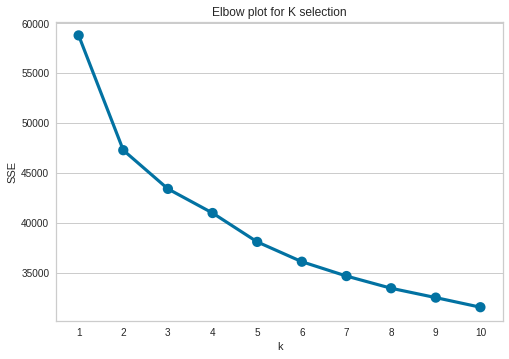

In [ ]:
# Display elbow point
def elbow_plot(df):
    """Create elbow plot from normalized data"""
    
    df_norm = preprocess(df)
    
    sse = {}
    
    for k in range(1, 11):
        kmeans = KMeans(n_clusters=k, random_state=1)
        kmeans.fit(df_norm)
        sse[k] = kmeans.inertia_
    
    plt.title('Elbow plot for K selection')
    plt.xlabel('k')
    plt.ylabel('SSE')
    sns.pointplot(x=list(sse.keys()),
                 y=list(sse.values()))
    plt.show()

elbow_plot(dataset)

Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x7f00e10564c0>
Traceback (most recent call last):
  File "/usr/local/lib/python3.8/dist-packages/threadpoolctl.py", line 584, in match_library_callback
    self._make_controller_from_path(filepath)
  File "/usr/local/lib/python3.8/dist-packages/threadpoolctl.py", line 725, in _make_controller_from_path
    lib_controller = lib_controller_class(
  File "/usr/local/lib/python3.8/dist-packages/threadpoolctl.py", line 842, in __init__
    super().__init__(**kwargs)
  File "/usr/local/lib/python3.8/dist-packages/threadpoolctl.py", line 810, in __init__
    self._dynlib = ctypes.CDLL(filepath, mode=_RTLD_NOLOAD)
  File "/usr/lib/python3.8/ctypes/__init__.py", line 373, in __init__
    self._handle = _dlopen(self._name, mode)
OSError: /usr/local/lib/python3.8/dist-packages/numpy.libs/libopenblas64_p-r0-2f7c42d4.3.18.so: cannot open shar

{1: 58776.00000000007, 2: 47268.386141144634, 3: 43390.42422464301, 4: 40969.63845344825, 5: 38076.322594183446, 6: 36089.21476398684, 7: 34651.03696505257, 8: 33428.592639953225, 9: 32490.4193411596, 10: 31528.231226535227}
range(1, 11)


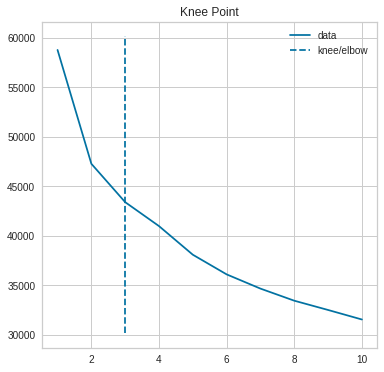

In [ ]:
# Display knee point
df_norm = preprocess(dataset)

sse = {}

for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=1)
    kmeans.fit(df_norm)
    sse[k] = kmeans.inertia_

print(sse)
print(range(1, 11))

kneedle = KneeLocator(x=list(sse.keys()), y=list(sse.values()), S=1.0, curve="convex", direction="decreasing")

# Raw data and knee
kneedle.plot_knee()

The elbow method is ambigious and could be at multiple spots on the curve. It appears a little sharper at 2 but not by much. The kneed method suggests 3 is the optimal number of clusters. We decided to analyze both and start with kmeans.

# Create a Model

# Analyze using 2 clusters with kmeans



In [ ]:
kmeans2 = create_model('kmeans', num_clusters=2)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.1774,1084.6657,1.9648,0,0,0


INFO:logs:create_model_container: 1
INFO:logs:master_model_container: 1
INFO:logs:display_container: 2
INFO:logs:KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=123, tol=0.0001, verbose=0)
INFO:logs:create_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'tsne')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


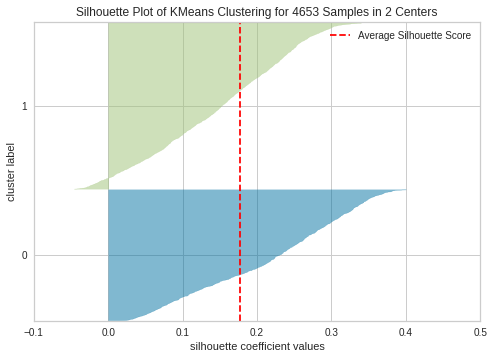

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'silhouette')

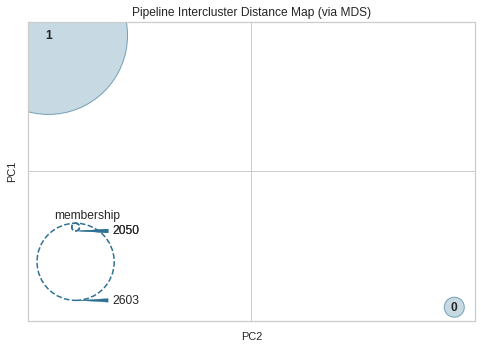

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distance')

In [ ]:
plot_model(kmeans2, plot = 'distribution') #to see size of clusters

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'fixed acidity')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'volatile acidity')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'citric acid')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'residual sugar')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'chlorides')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'free sulfur dioxide')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'total sulfur dioxide')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'density')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'pH')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'sulphates')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'distribution', feature = 'alcohol')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2)

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


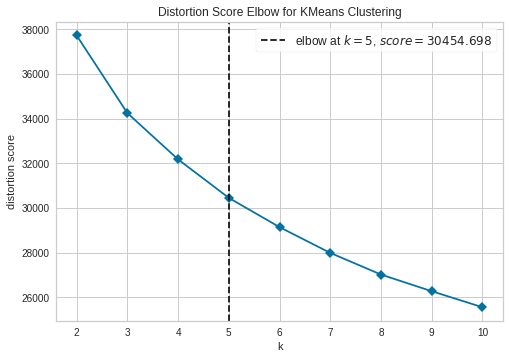

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans2, plot = 'elbow')

# Analyze using 3 clusters with kmeans

In [ ]:
kmeans3 = create_model('kmeans', num_clusters=3)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.1492,833.2843,2.1425,0,0,0


INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO:logs:display_container: 3
INFO:logs:KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=3, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=123, tol=0.0001, verbose=0)
INFO:logs:create_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'tsne')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


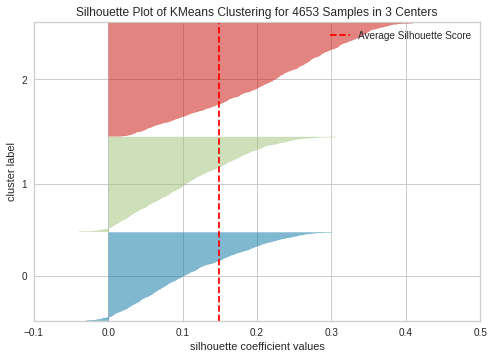

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'silhouette')

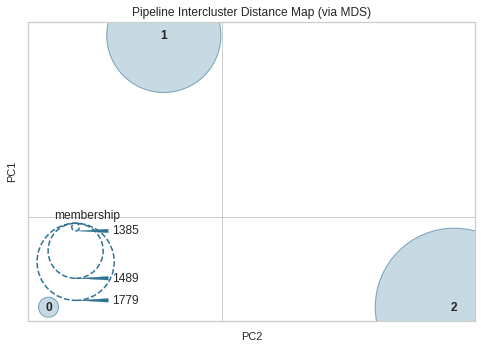

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distance')

In [ ]:
plot_model(kmeans3, plot = 'distribution') #to see size of clusters

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'fixed acidity')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'volatile acidity')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'citric acid')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'residual sugar')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'chlorides')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'free sulfur dioxide')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'total sulfur dioxide')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'density')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'pH')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'sulphates')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'alcohol')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'distribution', feature = 'sulphates')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3)

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


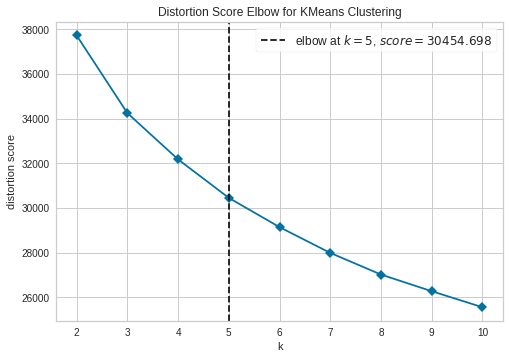

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans3, plot = 'elbow')

# Analyze using 5 clusters with kmeans
Since both elbow plots suggested the optimal clusters is 5, we will investigate a model with 5 clusters.

In [ ]:
kmeans5 = create_model('kmeans', num_clusters=5)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.1216,613.3528,2.0593,0,0,0


INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 4
INFO:logs:KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=5, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=123, tol=0.0001, verbose=0)
INFO:logs:create_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'tsne')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


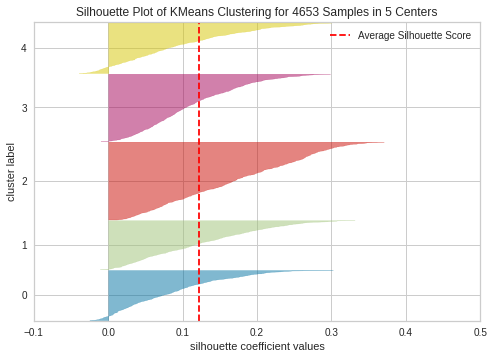

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'silhouette')

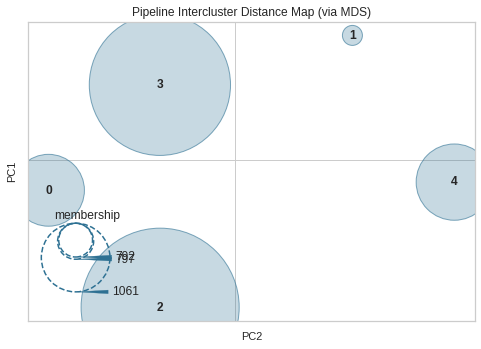

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distance')

In [ ]:
plot_model(kmeans5, plot = 'distribution') #to see size of clusters

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'fixed acidity')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'volatile acidity')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'citric acid')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'residual sugar')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'chlorides')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'free sulfur dioxide')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'total sulfur dioxide')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'density')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'density')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'pH')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'sulphates')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5, plot = 'distribution', feature = 'alcohol')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmeans5)

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


The model using 2 clusters had a higher Silhouette Coefficient (0.1674) and Calinski-Harabasz Index (1014.517) than the other 2 models. The Bouldin Score (2.05) was sligher lower than the model with 3 clusters but higher than the model with 5 clusters. The Silhoutte Coefficient represents how similar an object is to its own cluster.  The Calinski-Harabasz Index represents how similar an object is to its own cluster compared to other clusters. The  Bouldin Index is a ratio between the cluster scatter and the cluster's separation and a lower value will mean that the clustering is better. Since the model using 2 clusters performed better overall compared to the other 2, going forward we will use 2 clusters.

# Compare the kmeans result with 3 other clustering methods (kmodes, dbscan and hclust)

# Analyze using 2 clusters with kmodes

In [ ]:
kmodes = create_model('kmodes', num_clusters=2)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,-0.0076,1.8441,39.4337,0,0,0


INFO:logs:create_model_container: 4
INFO:logs:master_model_container: 4
INFO:logs:display_container: 5
INFO:logs:KModes(cat_dissim=<function matching_dissim at 0x7f00d1642160>, init='Cao',
       max_iter=100, n_clusters=2, n_init=1, n_jobs=-1, random_state=123,
       verbose=0)
INFO:logs:create_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'tsne')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


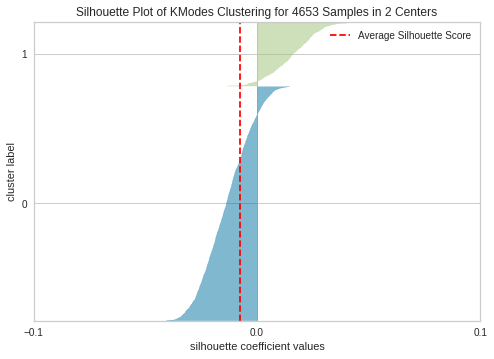

INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'silhouette')

In [ ]:
plot_model(kmodes, plot = 'distribution') #to see size of clusters

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'distribution', feature = 'fixed acidity')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'distribution', feature = 'volatile acidity')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'distribution', feature = 'citric acid')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'distribution', feature = 'residual sugar')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'distribution', feature = 'chlorides')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'distribution', feature = 'free sulfur dioxide')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'distribution', feature = 'total sulfur dioxide')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'distribution', feature = 'density')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'distribution', feature = 'pH')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes, plot = 'distribution', feature = 'sulphates')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:

plot_model(kmodes, plot = 'distribution', feature = 'alcohol')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(kmodes)

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


# Analyze using 2 clusters with dbscan

In [ ]:
dbscan = create_model('dbscan', num_clusters=2)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,-0.3303,6.1185,1.0613,0,0,0


INFO:logs:create_model_container: 5
INFO:logs:master_model_container: 5
INFO:logs:display_container: 6
INFO:logs:DBSCAN(algorithm='auto', eps=0.5, leaf_size=30, metric='euclidean',
       metric_params=None, min_samples=5, n_jobs=-1, p=None)
INFO:logs:create_model() succesfully completed......................................


In [ ]:
plot_model(dbscan, plot = 'tsne')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(dbscan, plot = 'distribution')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(dbscan)

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


# Analyze using 2 clusters with hclust

In [ ]:
hclust = create_model('hclust', num_clusters=2)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.1446,845.2623,2.1624,0,0,0


INFO:logs:create_model_container: 6
INFO:logs:master_model_container: 6
INFO:logs:display_container: 7
INFO:logs:AgglomerativeClustering(affinity='euclidean', compute_full_tree='auto',
                        connectivity=None, distance_threshold=None,
                        linkage='ward', memory=None, n_clusters=2)
INFO:logs:create_model() succesfully completed......................................


In [ ]:
plot_model(hclust, plot = 'tsne')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(hclust, plot = 'distribution') #to see size of clusters

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(hclust, plot = 'distribution', feature = 'residual sugar')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(hclust, plot = 'distribution', feature = 'free sulfur dioxide')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(hclust, plot = 'distribution', feature = 'total sulfur dioxide')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(hclust, plot = 'distribution', feature = 'density')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


In [ ]:
plot_model(hclust, plot = 'distribution', feature = 'alcohol')

INFO:logs:Rendering Visual


INFO:logs:Visual Rendered Successfully
INFO:logs:plot_model() succesfully completed......................................


# Assign a Model
After analysing the dataset with other clustering methods, kmeans still performed the best with the highest Silhouette Coefficient (0.1674) and Calinski-Harabasz Index (1014.517) and lowest Bouldin Score (2.05). hclust provided very similar results and had the second best with a Silhouette Coefficient of 0.1446, Calinski-Harabasz Index of 845.2623 and Bouldin Score of 2.1624. kmodes and dbscan both had negative Silhouette Coefficients but performed badly but in very different ways. kmodes was able to separate the data into 2 roughly equivalent clusters but every feature had a very similar distribution curve and range. With kmodes, LCBO would not be able to provide any differentiable qualities to their customers between the clusters. dbscan on the other hand, separated the data into 22 clusters even though we specified to use 2, placing most of the data in 1 cluster. Going forward we will use the model using 2 clusters with kmeans.

In [ ]:
kmean_results = assign_model(kmeans2)
kmean_results

INFO:logs:Initializing assign_model()
INFO:logs:assign_model(model=KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=123, tol=0.0001, verbose=0), transformation=False, score=True, verbose=True)
INFO:logs:Checking exceptions
INFO:logs:Determining Trained Model
INFO:logs:Trained Model : K-Means Clustering
INFO:logs:Copying data
INFO:logs:(4653, 13)
INFO:logs:assign_model() succesfully completed......................................


,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,Cluster
0,7.9,0.28,0.49,7.7,0.045,48.0,195.0,0.99540,3.040000,0.55,11.0,6,Cluster 0
1,5.0,0.24,0.19,5.0,0.043,17.0,101.0,0.99438,3.637107,0.57,10.0,5,Cluster 1
2,8.3,0.26,0.31,2.0,0.029,14.0,141.0,0.99077,2.950000,0.77,12.2,6,Cluster 1
3,7.7,0.25,0.30,7.8,0.038,67.0,196.0,0.99555,3.100000,0.50,10.1,5,Cluster 0
4,4.4,0.32,0.39,4.3,0.030,31.0,127.0,0.98904,3.460000,0.36,12.8,8,Cluster 1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4648,7.2,0.08,0.49,1.3,0.050,18.0,148.0,0.99450,3.460000,0.44,10.2,6,Cluster 1
4649,7.6,0.10,0.33,1.0,0.031,33.0,93.0,0.99094,3.060000,0.68,11.2,6,Cluster 1
4650,6.6,0.24,0.29,2.0,0.023,19.0,86.0,0.99000,3.250000,0.45,12.5,6,Cluster 1
4651,7.3,0.24,0.39,3.6,0.024,35.0,116.0,0.99280,3.170000,0.51,10.9,5,Cluster 1


# Predict on unseen data
As a demonstration of how the model works, we predict the quality of wines in the 5% holdout data that we removed at the begining of the notebook before feature engineering.

In [ ]:
# 5% sample witheld in the beginning
data_unseen.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.9951,3.26,0.44,10.1,6
1,8.6,0.23,0.40,4.2,0.035,17.0,109.0,0.9947,3.14,0.53,9.7,5
2,6.6,0.16,0.40,1.5,0.044,48.0,143.0,0.9912,3.54,0.52,12.4,7
3,7.4,0.34,0.42,1.1,0.033,17.0,171.0,0.9917,3.12,0.53,11.3,6
4,6.0,0.19,0.26,12.4,0.048,50.0,147.0,0.9972,3.30,0.36,8.9,6


In [ ]:
unseen_predictions = predict_model(kmeans2, data=data_unseen)
unseen_predictions

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=123, tol=0.0001, verbose=0), ml_usecase=MLUsecase.CLUSTERING)


,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality,Cluster
0,8.1,0.28,0.40,6.9,0.050,30.0,97.0,0.99510,3.26,0.44,10.10,6,Cluster 1
1,8.6,0.23,0.40,4.2,0.035,17.0,109.0,0.99470,3.14,0.53,9.70,5,Cluster 1
2,6.6,0.16,0.40,1.5,0.044,48.0,143.0,0.99120,3.54,0.52,12.40,7,Cluster 1
3,7.4,0.34,0.42,1.1,0.033,17.0,171.0,0.99170,3.12,0.53,11.30,6,Cluster 1
4,6.0,0.19,0.26,12.4,0.048,50.0,147.0,0.99720,3.30,0.36,8.90,6,Cluster 0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
240,5.3,0.31,0.38,10.5,0.031,53.0,140.0,0.99321,3.34,0.46,11.70,6,Cluster 1
241,5.5,0.16,0.31,1.2,0.026,31.0,68.0,0.98980,3.33,0.44,11.65,6,Cluster 1
242,6.6,0.29,0.73,2.2,0.027,21.0,92.0,0.99000,3.12,0.48,12.40,6,Cluster 1
243,6.2,0.23,0.38,1.6,0.044,12.0,113.0,0.99176,3.30,0.73,11.40,5,Cluster 1


# Saving the model

In [ ]:
#save model
save_model(kmeans2,'kmeans_final_pipeline')

INFO:logs:Initializing save_model()
INFO:logs:save_model(model=KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=2, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=123, tol=0.0001, verbose=0), model_name=kmeans_final_pipeline, prep_pipe_=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=[],
                                      display_types=True,
                                      features_todrop=['quality'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=[],
                                      target='UNSUPERVISED_DUMMY_TARGET',
                                      time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='most frequent',
                                fill_value_categorical=None,
                            

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True,
                                       features_todrop=['quality'],
                                       id_columns=[], ml_usecase='regression',
                                       numerical_features=[],
                                       target='UNSUPERVISED_DUMMY_TARGET',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='most frequent',
                                 fill_value_categorical=None,
                                 fill_value_numer...
                  Fix_multicollinearity(correlation_with_target_preference=None,
                                        correlation_with_target_threshold=0.0,
                                        target_variable='UNSUPERVISED_DUMMY_TARGET',
                       

# Conclusions

From our analysis, the best clustering model we found was the model created using the kmeans method and 2 clusters:
* It had the highest Silhoutte Coefficient which represents how similar an object is to its own cluster.
* It had the highest Calinski-Harabasz Index which represents how similar an object is to its own cluster compared to other clusters.
* It had the second lowest Bouldin Score which is a ratio between the cluster scatter and the cluster's separation and a lower value will mean that the clustering is better.
* Using visual inspection, all the plots suggested better clustering overall compared to other models.

With 2 clusters (Cluster 0, Cluster 1), our client LCBO can provide the following information to its customer to help them find the right wine for any occassion:

1. Fixed acidity:
> Wines lacking fixed acids will feel flabby and flat.  Customers will find wines from Cluster 1 flatter on average.

2. Volatile acidity:
> Volatile acidity gives off the odour of vinegar. Both clusters had relatively similar amounts so LCBO would not be able to use this feature as a selling feature. 

3. Citric acid:
> Citric acid imparts a citric character that enhances the taste of many white and blush wines. Cluster 0, had more wines with higher concentrations of citric acid. Customers will find wines from Cluster 0 to have more of a citric taste.

4. residual sugar:
> The more residual sugar remaining in a wine, the sweeter the wine is. Cluster 0, on average, is significantly sweeter. On the flipside, Cluster 1, on average, is more of a dry wine.

5. Chlorides:
> Chlorides give the wine a salty flavour. Cluster 0, on average, is a little more saltier. On the flipside, Cluster 1, on averages, is less saltier.

6. Free sulfur dioxide, total sulfur dioxide and sulphates:
> Some customers may be sensitive to these compounds. Cluster 0, on average, has a little higher concentration of these compounds. If these customers are sensitive to these compounds, then Cluster 1 may be a better choice.

7. Density:
> The higher the density the harder it is to drink, and on the flipside, the lower the density the easier it is to drink. Cluster 0, on average, is more full-bodied. On the flipside, Cluster 1, on average, is a lighter wine.

8. pH:
> Fundamentally speaking, all wines lie on the acidic side of the pH spectrum, and most range from 2.5 - 4.5 pH. The findings support this so LCBO can confirm to their customers that all their wines have a safe pH range.

9. Alcohol:
> On average, Cluster 1 has a higher concentration of alcohol. If customers want lower concentrations of alcohol, Cluster 0 would be a better choice.

## References

Arvai, Kevin. "Knee/Elbow Point Detection." Kaggle, Kaggle, 11 Dec. 2019, https://www.kaggle.com/code/kevinarvai/knee-elbow-point-detection. 

Clarke, Matt. "How to Use Knee Point Detection in K Means Clustering." Practical Data Science, 12 Mar. 2021, https://practicaldatascience.co.uk/machine-learning/how-to-use-knee-point-detection-in-k-means-clustering.

Cortez, P., Cerdeira, A., Almeida, F., Matos, T., and Reis, J.
Modeling wine preferences by data mining from physicochemical properties. In Decision Support Systems, Elsevier, 47(4):547-553, 2009.

Mani, S., Krishnankutty, R. A., Swaminathan, S., & Theerthagiri, P. (2023). An investigation of wine quality testing using machine learning techniques. IAES International Journal of Artificial Intelligence, 12(2), 747.

SrijanP01. “‘The Elbow Method’: Data Science and Machine Learning.” Kaggle, https://www.kaggle.com/getting-started/304396. 